Plotting Similarity score for pair of images in the dataset, output give by "OpenGVLab/Mini-InternVL-Chat-2B-V1-5"


The plot is ploted as Image 1, Image2, Similarity Score

In [1]:
!kaggle datasets download -d marqui"s03/bdd100k"

Dataset URL: https://www.kaggle.com/datasets/marquis03/bdd100k
License(s): apache-2.0
100% 5.37G/5.38G [00:58<00:00, 152MB/s]
100% 5.38G/5.38G [00:58<00:00, 99.1MB/s]


In [2]:
import zipfile

with zipfile.ZipFile('/content/bdd100k.zip', 'r') as zip_ref:
    zip_ref.extractall()

In [3]:
print("Hello People");

Hello People


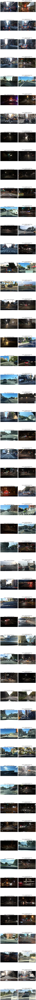

In [11]:
import matplotlib.pyplot as plt
from PIL import Image
import os

# Directory where the images are stored
image_dir = "/content/train/images"
# Data extracted from the text
data = [
    ("00091078-59817bb0.jpg", "00091078-7cff8ea6.jpg", 90.32),
    ("00091078-84635cf2.jpg", "00091078-875c1f73.jpg", 87.10),
    ("00091078-c1d32eea.jpg", "00091078-cedbfea7.jpg", 93.55),
    ("00091078-f32de4d2.jpg", "000d35d3-41990aa4.jpg", 67.74),
    ("000d4f89-3bcbe37a.jpg", "000e0252-8523a4a9.jpg", 96.77),
    ("000f157f-30b30f5e.jpg", "000f157f-37797ff9.jpg", 58.06),
    ("000f157f-dab3a407.jpg", "000f8d37-d4c09a0f.jpg", 90.32),
    ("02d478d1-9774e131.jpg", "02d478d1-9ce5120d.jpg",  100),
    ("02d478d1-937f841f.jpg", "02d478d1-94733b99.jpg", 96.8),
    ("01f087ee-aa19ac33.jpg", "01f087ee-e1c08372.jpg", 100),
    ("0226f407-491ed238.jpg", "0226f407-513227af.jpg", 100),
    ("036a6bf9-95a6990b.jpg", "036aaaef-c0fecc6a.jpg",  54.83),
    ("030c8a82-7161e818.jpg", "030e8b7a-4dab7745.jpg",  58.06),
    ("031637c4-b28f871a.jpg", "031637c4-bc0eaa8e.jpg",  45.16),
    ("03730160-cb96fffb.jpg", "0373026a-6b400710.jpg",  54.83),
    ("0000f77c-6257be58.jpg", "0000f77c-62c2a288.jpg", 83.87),
    ("0000f77c-cb820c98.jpg", "0001542f-5ce3cf52.jpg", 77.42),
    ("0001542f-7c670be8.jpg", "0001542f-ec815219.jpg", 83.87),
    ("0004974f-05e1c285.jpg", "00054602-3bf57337.jpg", 77.42),
    ("00067cfb-5443fe39.jpg", "00067cfb-5adfaaa7.jpg", 67.74),
    ("00067cfb-caba8a02.jpg", "00067cfb-e535423e.jpg", 70.97),
    ("00067cfb-f1b91e3c.jpg", "0008a165-c48f4b3e.jpg", 80.65),
    ("0386df8d-bf0099c3.jpg", "0386df8d-c884dc14.jpg",  100),
    ("00131ea7-624f538d.jpg", "00134776-9123d227.jpg", 67.74),
    ("001bad4e-2fa8f3b6.jpg", "001c5339-08faca55.jpg", 58.06),
    ("001c5339-13a07470.jpg", "001c5339-9a6cdd3e.jpg", 93.55),
    ("00202076-7a95b4e3.jpg", "00202076-9eaa8e42.jpg", 83.87),
    ("00207869-046fa443.jpg", "00207869-902288d1.jpg", 87.10),
    ("00211b17-ad3e206b.jpg", "00225f53-4200bde2.jpg", 67.74),
    ("00225f53-67614580.jpg", "00232de3-19eca24a.jpg", 70.97),
    ("0024b742-83709bd4.jpg", "0024b742-acbed4fb.jpg", 77.42),
    ("002685b6-856c17f7.jpg", "00268999-0b20ef00.jpg", 48.39),
    ("00268999-9f6d5823.jpg", "00268999-a4b8e39d.jpg", 70.97),
    ("00268999-cb063914.jpg", "002827ad-8748e2fb.jpg", 70.97),
    ("0028cbbf-92f30408.jpg", "002ab96a-a96704f9.jpg", 58.06),
    ("002ab96a-ea678692.jpg", "002b485a-3f6603f2.jpg", 80.65),
    ("002b485a-d1301c7c.jpg", "002b562f-e0ac84fe.jpg", 64.52),
    ("002cd38e-c7defded.jpg", "002cd38e-ebe888e1.jpg", 67.74),
    ("002d290d-01969e7d.jpg", "002d290d-89d1aea8.jpg", 93.55),
    ("002d290d-89f4e5c0.jpg", "002d290d-90f2bab2.jpg", 70.97),
    ("002d290d-f9108a13.jpg", "002d290d-fa2a8964.jpg", 74.19),
    ("002e6895-442e6bc1.jpg", "002f8552-0cdd55c6.jpg", 64.52),
    ("0030f434-3eb4a3a9.jpg", "00313a01-62156032.jpg", 77.42),
    ("00313a01-725ddf3a.jpg", "00313a01-97de1f42.jpg", 87.10),
    ("00313a01-b53a2998.jpg", "00322f82-286ab9b3.jpg", 93.55),
    ("0032419c-7d20b300.jpg", "0033b19f-65613f7e.jpg", 58.06),
    ("0033b19f-7f07efac.jpg", "0034a363-24f318c4.jpg", 70.97),
    ("0035afff-3295dbd6.jpg", "0035afff-434368a1.jpg", 96.77),
    ("0035afff-47378fa3.jpg", "0035afff-572b2d4e.jpg", 70.97),
    ("0035afff-bd191d6a.jpg", "00378858-c5f802ac.jpg", 70.97),
    ("00390995-49d9a01e.jpg", "00391a82-8be5b76d.jpg", 74.19),
    ("00391a82-d1428e56.jpg", "003baca5-70c87fc6.jpg", 74.19),
    ("0010bf16-9ee17cd9.jpg", "0010bf16-a457685b.jpg", 77.42),
    ("003baca5-aab2e274.jpg", "003baca5-ad660439.jpg", 80.65)
]


# Function to plot image pairs
def plot_image_pairs(data, image_dir):
    fig, axes = plt.subplots(len(data), 2, figsize=(10, len(data) * 5))
    for i, (img1, img2, similarity) in enumerate(data):
        # Load images
        img1_path = os.path.join(image_dir, img1)
        img2_path = os.path.join(image_dir, img2)

        try:
            image1 = Image.open(img1_path)
            image2 = Image.open(img2_path)
        except FileNotFoundError as e:
            print(f"Error: {e}")
            continue

        # Display images
        axes[i, 0].imshow(image1)
        axes[i, 0].axis("off")
        axes[i, 0].set_title(f"Image 1: {img1}")

        axes[i, 1].imshow(image2)
        axes[i, 1].axis("off")
        axes[i, 1].set_title(f"Image 2: {img2}\nSimilarity: {similarity:.2f}%")

    plt.tight_layout()
    plt.show()

# Call the function
plot_image_pairs(data, image_dir)
